In [2]:
import pandas as pd
import numpy as np

## Data Processing

In [2]:
df = pd.read_csv("/CarePre/ADMISSIONS.csv")

In [3]:
from os import listdir
from os.path import isfile, join
mypath = "/CarePre"
onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]

In [4]:
onlyfiles

['SERVICES.csv',
 'CALLOUT.csv',
 'TRANSFERS.csv',
 'CPTEVENTS.csv',
 'D_CPT.csv',
 'D_ICD_PROCEDURES.csv',
 'DATETIMEEVENTS.csv',
 'D_ITEMS.csv',
 'PRESCRIPTIONS.csv',
 'OUTPUTEVENTS.csv',
 'DIAGNOSES_ICD.csv',
 'INPUTEVENTS_CV.csv',
 'PROCEDUREEVENTS_MV.csv',
 'NOTEEVENTS.csv',
 'ADMISSIONS.csv',
 'PATIENTS.csv',
 'CHARTEVENTS.csv',
 'CAREGIVERS.csv',
 'PROCEDURES_ICD.csv',
 'INPUTEVENTS_MV.csv',
 'D_ICD_DIAGNOSES.csv',
 'D_LABITEMS.csv',
 'ICUSTAYS.csv',
 'LABEVENTS.csv',
 'MICROBIOLOGYEVENTS.csv']

In [4]:
prescriptions = pd.read_csv("/CarePre/PRESCRIPTIONS.csv",low_memory=False)
#prescriptions.head()

In [5]:
patients = pd.read_csv("/CarePre/PATIENTS.csv")
patients.SUBJECT_ID.nunique()

46520

In [6]:
admissions = pd.read_csv('/CarePre/ADMISSIONS.csv')
admissions.head()

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,LANGUAGE,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA
0,21,22,165315,2196-04-09 12:26:00,2196-04-10 15:54:00,NaN,EMERGENCY,EMERGENCY ROOM ADMIT,DISC-TRAN CANCER/CHLDRN H,Private,NaN,UNOBTAINABLE,MARRIED,WHITE,2196-04-09 10:06:00,2196-04-09 13:24:00,BENZODIAZEPINE OVERDOSE,0,1
1,22,23,152223,2153-09-03 07:15:00,2153-09-08 19:10:00,NaN,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,NaN,CATHOLIC,MARRIED,WHITE,NaN,NaN,CORONARY ARTERY DISEASE\CORONARY ARTERY BYPASS...,0,1
2,23,23,124321,2157-10-18 19:34:00,2157-10-25 14:00:00,NaN,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME HEALTH CARE,Medicare,ENGL,CATHOLIC,MARRIED,WHITE,NaN,NaN,BRAIN MASS,0,1
3,24,24,161859,2139-06-06 16:14:00,2139-06-09 12:48:00,NaN,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME,Private,NaN,PROTESTANT QUAKER,SINGLE,WHITE,NaN,NaN,INTERIOR MYOCARDIAL INFARCTION,0,1
4,25,25,129635,2160-11-02 02:06:00,2160-11-05 14:55:00,NaN,EMERGENCY,EMERGENCY ROOM ADMIT,HOME,Private,NaN,UNOBTAINABLE,MARRIED,WHITE,2160-11-02 01:01:00,2160-11-02 04:27:00,ACUTE CORONARY SYNDROME,0,1


In [7]:
diagnoses = pd.read_csv('/CarePre/DIAGNOSES_ICD.csv')
diagnoses.head()

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
0,1297,109,172335,1.0,40301
1,1298,109,172335,2.0,486
2,1299,109,172335,3.0,58281
3,1300,109,172335,4.0,5855
4,1301,109,172335,5.0,4254


In [8]:
pd.options.display.max_columns = 25
procedures = pd.read_csv('/CarePre/PROCEDURES_ICD.csv')
procedures.head()

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
0,944,62641,154460,3,3404
1,945,2592,130856,1,9671
2,946,2592,130856,2,3893
3,947,55357,119355,1,9672
4,948,55357,119355,2,331


In [9]:
D_procedures_icd=pd.read_csv('/CarePre/D_ICD_PROCEDURES.csv')
procedures[procedures.SUBJECT_ID==25724]

,ROW_ID,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
131079,129191,25724,196248,1,66
131080,129192,25724,196248,2,3607
131081,129193,25724,196248,3,3722
131082,129194,25724,196248,4,8856
131083,129195,25724,196248,5,8853
131084,129196,25724,196248,6,45
131085,129197,25724,196248,7,40
131086,129198,25724,196248,8,9920


In [10]:
D_diag_icd = pd.read_csv('/CarePre/D_ICD_DIAGNOSES.csv')


In [11]:
diag_icd = pd.read_csv('/CarePre/DIAGNOSES_ICD.csv')

In [12]:
merge1 = pd.merge(admissions[['SUBJECT_ID','HADM_ID','ADMITTIME','ADMISSION_TYPE']],diag_icd, how = 'left',on = ['SUBJECT_ID','HADM_ID'])
merge2 = pd.merge(merge1,D_diag_icd[['ICD9_CODE','SHORT_TITLE']],how = 'left',on = 'ICD9_CODE')

In [13]:
diag_df = merge2.rename(columns = {'ICD9_CODE':'ICD_9'})

In [14]:
merge3 = pd.merge(admissions[['SUBJECT_ID','HADM_ID','ADMITTIME','ADMISSION_TYPE']],procedures,
                    how = 'inner',on = ['SUBJECT_ID','HADM_ID'])
merge4 = pd.merge(merge3,D_procedures_icd[['ICD9_CODE','SHORT_TITLE']],how = 'inner',on = 'ICD9_CODE')

In [15]:
procedure_df = merge4.rename(columns = {'ICD9_CODE':'ICD_9'})

In [16]:
prescriptions_df = prescriptions[['SUBJECT_ID','HADM_ID',
                                  'STARTDATE','FORMULARY_DRUG_CD']].rename(columns = {'STARTDATE':'ADMITTIME'})

In [17]:
prescriptions_df.head(1)

,SUBJECT_ID,HADM_ID,ADMITTIME,FORMULARY_DRUG_CD
0,6,107064,2175-06-11 00:00:00,TACR1


In [18]:
diag_df['event_type']='Diagnose'

In [19]:
procedure_df['event_type']='Procedure'

In [20]:
df_clean=pd.concat([diag_df, procedure_df]).sort_values(by=['SUBJECT_ID','ADMITTIME','SEQ_NUM'])

In [21]:
df_clean.dropna()

,SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ROW_ID,SEQ_NUM,ICD_9,SHORT_TITLE,event_type
2044,2,163353,2138-07-17 19:04:00,NEWBORN,1,1.0,V3001,Single lb in-hosp w cs,Diagnose
63756,2,163353,2138-07-17 19:04:00,NEWBORN,109376,1.0,9955,Vaccination NEC,Procedure
2045,2,163353,2138-07-17 19:04:00,NEWBORN,2,2.0,V053,Need prphyl vc vrl hepat,Diagnose
2046,2,163353,2138-07-17 19:04:00,NEWBORN,3,3.0,V290,NB obsrv suspct infect,Diagnose
2047,3,145834,2101-10-20 19:08:00,EMERGENCY,4,1.0,0389,Septicemia NOS,Diagnose
32,3,145834,2101-10-20 19:08:00,EMERGENCY,44184,1.0,9604,Insert endotracheal tube,Procedure
2048,3,145834,2101-10-20 19:08:00,EMERGENCY,5,2.0,78559,Shock w/o trauma NEC,Diagnose
198700,3,145834,2101-10-20 19:08:00,EMERGENCY,44185,2.0,9962,Heart countershock NEC,Procedure
2049,3,145834,2101-10-20 19:08:00,EMERGENCY,6,3.0,5849,Acute kidney failure NOS,Diagnose
74743,3,145834,2101-10-20 19:08:00,EMERGENCY,44186,3.0,8964,Pulmon art wedge monitor,Procedure


In [33]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 897225 entries, 2044 to 156977
Data columns (total 9 columns):
SUBJECT_ID        897225 non-null int64
HADM_ID           897225 non-null int64
ADMITTIME         897225 non-null object
ADMISSION_TYPE    897225 non-null object
ROW_ID            897225 non-null int64
SEQ_NUM           897178 non-null float64
ICD_9             897178 non-null object
SHORT_TITLE       880887 non-null object
event_type        897225 non-null object
dtypes: float64(1), int64(3), object(5)
memory usage: 68.5+ MB


In [34]:
df_clean.tail()

,SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ROW_ID,SEQ_NUM,ICD_9,SHORT_TITLE,event_type
156676,99999,113369,2117-12-30 07:15:00,ELECTIVE,174287,3.0,8162,Fus/refus 2-3 vertebrae,Procedure
616538,99999,113369,2117-12-30 07:15:00,ELECTIVE,651046,4.0,25000,DMII wo cmp nt st uncntr,Diagnose
238084,99999,113369,2117-12-30 07:15:00,ELECTIVE,174288,4.0,9979,Other therapeu apheresis,Procedure
616539,99999,113369,2117-12-30 07:15:00,ELECTIVE,651047,5.0,4139,Angina pectoris NEC/NOS,Diagnose
156977,99999,113369,2117-12-30 07:15:00,ELECTIVE,174289,5.0,8451,Ins spinal fusion device,Procedure


In [22]:
df_clean['ICD_9'] = df_clean['ICD_9'].astype('str') 

In [23]:
df_clean[df_clean.SUBJECT_ID==2]

,SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ROW_ID,SEQ_NUM,ICD_9,SHORT_TITLE,event_type
2044,2,163353,2138-07-17 19:04:00,NEWBORN,1,1.0,V3001,Single lb in-hosp w cs,Diagnose
63756,2,163353,2138-07-17 19:04:00,NEWBORN,109376,1.0,9955,Vaccination NEC,Procedure
2045,2,163353,2138-07-17 19:04:00,NEWBORN,2,2.0,V053,Need prphyl vc vrl hepat,Diagnose
2046,2,163353,2138-07-17 19:04:00,NEWBORN,3,3.0,V290,NB obsrv suspct infect,Diagnose


In [24]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 897225 entries, 2044 to 156977
Data columns (total 9 columns):
SUBJECT_ID        897225 non-null int64
HADM_ID           897225 non-null int64
ADMITTIME         897225 non-null object
ADMISSION_TYPE    897225 non-null object
ROW_ID            897225 non-null int64
SEQ_NUM           897178 non-null float64
ICD_9             897225 non-null object
SHORT_TITLE       880887 non-null object
event_type        897225 non-null object
dtypes: float64(1), int64(3), object(5)
memory usage: 68.5+ MB


In [25]:
patient_dict = dict()
for index in df_clean.SUBJECT_ID.unique():
    patient = df_clean[df_clean['SUBJECT_ID'] == index][['ADMITTIME','ICD_9','SHORT_TITLE','event_type']]
    patient_dict[index] = []
    for i in range(len(patient)):
        stay = patient.iloc[i,:].to_dict()
        patient_dict[index].append(stay)

In [26]:
patient_dict

{2: [{'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V3001',
   'SHORT_TITLE': 'Single lb in-hosp w cs',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': '9955',
   'SHORT_TITLE': 'Vaccination NEC',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V053',
   'SHORT_TITLE': 'Need prphyl vc vrl hepat',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V290',
   'SHORT_TITLE': 'NB obsrv suspct infect',
   'event_type': 'Diagnose'}],
 3: [{'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '0389',
   'SHORT_TITLE': 'Septicemia NOS',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9604',
   'SHORT_TITLE': 'Insert endotracheal tube',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '78559',
   'SHORT_TITLE': 'Shock w/o trauma NEC',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9962',
   'SHORT_TI

In [27]:
#df_clean[df_clean.SUBJECT_ID==27149]

In [28]:
prescriptions_dict = dict()
for index in admissions.SUBJECT_ID.unique():
    patient = prescriptions_df[prescriptions_df['SUBJECT_ID'] == index][['ADMITTIME','FORMULARY_DRUG_CD']]
    prescriptions_dict[index] = []
    for i in range(len(patient)):
        stay = patient.iloc[i,:].to_dict()
        stay['event_type'] = 'Prescriptions'
        prescriptions_dict[index].append(stay)

In [29]:
procedure_dict = dict()
for index in admissions.SUBJECT_ID.unique():
    patient = procedure_df[procedure_df['SUBJECT_ID'] == index][['ADMITTIME','ICD_9','SHORT_TITLE']]
    procedure_dict[index] = []
    for i in range(len(patient)):
        stay = patient.iloc[i,:].to_dict()
        stay['event_type'] = 'Procedure'
        procedure_dict[index].append(stay)

In [30]:
prescriptions_dict

{2: [{'ADMITTIME': '2138-07-18 00:00:00',
   'FORMULARY_DRUG_CD': 'GENT10I',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2138-07-18 00:00:00',
   'FORMULARY_DRUG_CD': 'NEOSYRD5W',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2138-07-18 00:00:00',
   'FORMULARY_DRUG_CD': 'AMP500I',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2138-07-18 00:00:00',
   'FORMULARY_DRUG_CD': 'AMPVL',
   'event_type': 'Prescriptions'}],
 3: [],
 4: [{'ADMITTIME': '2191-03-16 00:00:00',
   'FORMULARY_DRUG_CD': 'VANCOBASE',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2191-03-16 00:00:00',
   'FORMULARY_DRUG_CD': 'GLAR100I',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2191-03-16 00:00:00',
   'FORMULARY_DRUG_CD': 'BENZ100',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2191-03-16 00:00:00',
   'FORMULARY_DRUG_CD': 'INSULIN',
   'event_type': 'Prescriptions'},
  {'ADMITTIME': '2191-03-16 00:00:00',
   'FORMULARY_DRUG_CD': 'DITU4L',
   'event_type': 'Prescriptions'},
  

In [31]:
patient_dict

{2: [{'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V3001',
   'SHORT_TITLE': 'Single lb in-hosp w cs',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': '9955',
   'SHORT_TITLE': 'Vaccination NEC',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V053',
   'SHORT_TITLE': 'Need prphyl vc vrl hepat',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V290',
   'SHORT_TITLE': 'NB obsrv suspct infect',
   'event_type': 'Diagnose'}],
 3: [{'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '0389',
   'SHORT_TITLE': 'Septicemia NOS',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9604',
   'SHORT_TITLE': 'Insert endotracheal tube',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '78559',
   'SHORT_TITLE': 'Shock w/o trauma NEC',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9962',
   'SHORT_TI

In [32]:
procedure_dict

{2: [{'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 9955,
   'SHORT_TITLE': 'Vaccination NEC',
   'event_type': 'Procedure'}],
 3: [{'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 9604,
   'SHORT_TITLE': 'Insert endotracheal tube',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 8964,
   'SHORT_TITLE': 'Pulmon art wedge monitor',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 3893,
   'SHORT_TITLE': 'Venous cath NEC',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 9672,
   'SHORT_TITLE': 'Cont inv mec ven 96+ hrs',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 966,
   'SHORT_TITLE': 'Entral infus nutrit sub',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': 9962,
   'SHORT_TITLE': 'Heart countershock NEC',
   'event_type': 'Procedure'}],
 4: [{'ADMITTIME': '2191-03-16 00:28:00',
   'ICD_9': 8872,
   'SHORT_TITLE'

In [33]:
## All features
result_dict = dict()
for index in admissions.SUBJECT_ID.unique():
    result_dict[index] = patient_dict[index]+procedure_dict[index]+prescriptions_dict[index]#sorted by 时间

In [34]:
##with open('clean_data.json', 'w') as fp:
##    json.dump(result_dict, fp)

In [35]:
df_clean[df_clean['SUBJECT_ID']==2]

,SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ROW_ID,SEQ_NUM,ICD_9,SHORT_TITLE,event_type
2044,2,163353,2138-07-17 19:04:00,NEWBORN,1,1.0,V3001,Single lb in-hosp w cs,Diagnose
63756,2,163353,2138-07-17 19:04:00,NEWBORN,109376,1.0,9955,Vaccination NEC,Procedure
2045,2,163353,2138-07-17 19:04:00,NEWBORN,2,2.0,V053,Need prphyl vc vrl hepat,Diagnose
2046,2,163353,2138-07-17 19:04:00,NEWBORN,3,3.0,V290,NB obsrv suspct infect,Diagnose


In [36]:

respiratory=list(set(df_clean[(df_clean.ICD_9.str.startswith('80'))&(df_clean.event_type=='Diagnose')]['SUBJECT_ID']))

In [37]:
#respiratory=list(set(df_clean[df_clean['ICD_9'].str.contains("V")]['SUBJECT_ID']))

In [38]:
#respiratory = list(df_clean[df_clean['ICD_9'].isin([str(x) for x in np.arange(80,799)])]['SUBJECT_ID'])

In [39]:
patient_dict

{2: [{'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V3001',
   'SHORT_TITLE': 'Single lb in-hosp w cs',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': '9955',
   'SHORT_TITLE': 'Vaccination NEC',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V053',
   'SHORT_TITLE': 'Need prphyl vc vrl hepat',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2138-07-17 19:04:00',
   'ICD_9': 'V290',
   'SHORT_TITLE': 'NB obsrv suspct infect',
   'event_type': 'Diagnose'}],
 3: [{'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '0389',
   'SHORT_TITLE': 'Septicemia NOS',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9604',
   'SHORT_TITLE': 'Insert endotracheal tube',
   'event_type': 'Procedure'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '78559',
   'SHORT_TITLE': 'Shock w/o trauma NEC',
   'event_type': 'Diagnose'},
  {'ADMITTIME': '2101-10-20 19:08:00',
   'ICD_9': '9962',
   'SHORT_TI

In [40]:
respira_dict = dict()
for index in respiratory:
    respira_dict[index] = patient_dict[index]

In [20]:
respiratory=sorted(respiratory)
len(respira_dict)

NameError: name 'respiratory' is not defined

In [42]:
for key in list(respira_dict):
    if type(key) is not str:
        try:
            respira_dict[str(key)] = respira_dict[key]
        except:
            try:
                respira_dict[repr(key)] = respira_dict[key]
            except:
                pass
    del respira_dict[key]

In [43]:
for key in list(patient_dict):
    if type(key) is not str:
        try:
            patient_dict[str(key)] = patient_dict[key]
        except:
            try:
                patient_dict[repr(key)] = patient_dict[key]
            except:
                pass
    del patient_dict[key]

In [46]:
with open('clean_data_sub.json', 'w') as fp:
    json.dump(respira_dict, fp)

In [45]:
import json

## Load Clean Dataset

In [1]:
import json
# reading the JSON data using json.load()
file = 'clean_data_sub.json'
with open(file) as train_file:
    dict_train = json.load(train_file)

# converting json dataset from dictionary to dataframe
train = pd.DataFrame.from_dict(dict_train, orient='index')
train.reset_index(level=0, inplace=True)

NameError: name 'pd' is not defined

### Use Patient ICD-9 in Word2Vec

In [4]:
total=[]
for patient in dict_train:
    test1=[]
    for num in range (0,len(dict_train[patient])):
        test1.append(dict_train[patient][num]['ICD_9'])
    total.append(test1)

In [5]:
total

[['51881',
  '9671',
  '49322',
  '966',
  '4660',
  '32723',
  '27801',
  '49122',
  '3893',
  '4241',
  '42832',
  '4280',
  '7907',
  '32723',
  '5300',
  '04119',
  '2859',
  '6930',
  '3893',
  '496',
  '4241',
  '42830',
  '4280',
  '7907',
  'E9308',
  '32723',
  '27801',
  '7823',
  '7242',
  '04111',
  'V090',
  '80625',
  '353',
  '51881',
  '311',
  '48242',
  '8105',
  '4821',
  '359',
  '5845',
  '8135',
  '0389',
  '9672',
  '99592',
  '7971',
  '78552',
  '3893',
  '49121',
  '14',
  '42832',
  '4311',
  '5990',
  '3322',
  '99851',
  '4513',
  '99931',
  '8452',
  'E8798',
  '8164',
  '4241',
  '8162',
  '4280',
  '0414',
  'E8788',
  '71831',
  '45829',
  '27801',
  '73300',
  '73743'],
 ['8244',
  '7936',
  '80705',
  '387',
  '86405',
  '7937',
  '86121',
  '9904',
  '4239',
  '29281',
  '2930',
  '82525',
  '4019',
  '53081',
  '311',
  '78830',
  '2409',
  '7210',
  '7876',
  '4928',
  '0539',
  'V5866',
  'E8120',
  'E9352',
  'E9354',
  'E9430',
  'E9390'],
 ['80

In [21]:
import gensim
from gensim.models import Word2Vec
model_ted = Word2Vec(sentences=total, size=100, window=20, min_count=1, workers=4, sg=1,iter=100)
#model_ted.wv.most_similar("80124")

In [22]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

### Draw the graph for Word2vec

In [11]:
def display_closestwords_tsnescatterplot(model, word):

    word_labels = [word]

    # get close words
    close_words = model.similar_by_word(word)
    vector_dim = model.vector_size
    # add the vector for each of the closest words to the array
    arr = np.empty((0,vector_dim), dtype='f')
    for wrd_score in close_words:
        wrd_vector = model[wrd_score[0]]
        word_labels.append(wrd_score[0])
        arr = np.append(arr, np.array([wrd_vector]), axis=0)
        
    # find tsne coords for 2 dimensions
    tsne = TSNE(n_components=2, random_state=0)
    np.set_printoptions(suppress=True)
    Y = tsne.fit_transform(arr)

    x_coords = Y[:, 0]
    y_coords = Y[:, 1]
    # display scatter plot
    plt.scatter(x_coords, y_coords)

    for label, x, y in zip(word_labels, x_coords, y_coords):
        plt.annotate(label, xy=(x, y), xytext=(0, 0), textcoords='offset points')
    plt.xlim(x_coords.min()+0.00005, x_coords.max()+0.00005)
    plt.ylim(y_coords.min()+0.00005, y_coords.max()+0.00005)
    plt.savefig('demonew_test++.png', bbox_inches='tight')

C:\Users\ariaa\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: Call to deprecated `similar_by_word` (Method will be removed in 4.0.0, use self.wv.similar_by_word() instead).
  
C:\Users\ariaa\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  # This is added back by InteractiveShellApp.init_path()


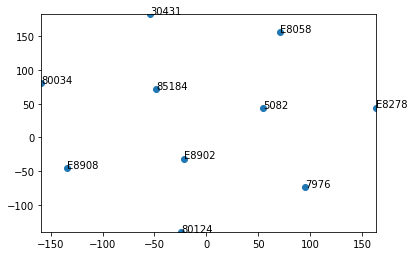

In [12]:
display_closestwords_tsnescatterplot(model_ted, '80124')

In [15]:
def display_wordlist(model, wordlist):
    vectors = [model[word] for word in wordlist if word in model.wv.vocab.keys()]
    word_labels = [word for word in wordlist if word in model.wv.vocab.keys()]
    word_vec_zip = zip(word_labels, vectors)

    # Convert to a dict and then to a DataFrame
    word_vec_dict = dict(word_vec_zip)
    df = pd.DataFrame.from_dict(word_vec_dict, orient='index')

    # Use tsne to reduce to 2 dimensions
    tsne = TSNE(perplexity=65,n_components=2, random_state=0)
    np.set_printoptions(suppress=True)
    Y = tsne.fit_transform(df)

    x_coords = Y[:, 0]
    y_coords = Y[:, 1]
    # display plot
    plt.figure(figsize=(16, 8)) 
    plt.plot(x_coords, y_coords, 'ro')

    for label, x, y in zip(df.index, x_coords, y_coords):
        plt.annotate(label, xy=(x, y), xytext=(5, 2), textcoords='offset points')
    plt.xlim(x_coords.min()+0.00005, x_coords.max()+0.00005)
    plt.ylim(y_coords.min()+0.00005, y_coords.max()+0.00005)
    plt.savefig('demo_test++.png', bbox_inches='tight')

In [14]:
model_ted.train(total,total_examples=len(total),epochs=10)


(492833, 577060)

C:\Users\ariaa\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


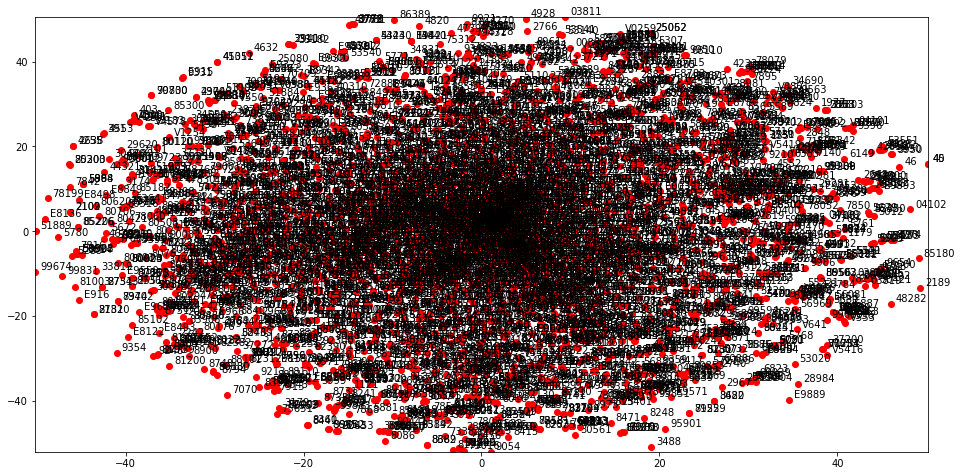

In [16]:
display_wordlist(model_ted, wordlist=list(model_ted.wv.vocab))

### Similar ICD-9

In [17]:
model_ted.wv.most_similar('4822')

[('48230', 0.55992591381073),
 ('38908', 0.5343918204307556),
 ('7929', 0.5210431814193726),
 ('80436', 0.5051591396331787),
 ('9539', 0.4920658767223358),
 ('7596', 0.48824524879455566),
 ('80430', 0.4861200451850891),
 ('80410', 0.47893157601356506),
 ('80851', 0.46246621012687683),
 ('3323', 0.45945271849632263)]

In [23]:
my_dict = dict()
for idx, key in enumerate(model_ted.wv.vocab):
    my_dict[key] = model_ted.wv[key]
    # Or my_dict[key] = model.wv.get_vector(key)
    # Or my_dict[key] = model.wv.word_vec(key, use_norm=False)

In [16]:
type(my_dict)

dict

In [24]:
with open('word_embedding_partial.json', 'w') as fp:
    json.dump(my_dict,fp)

TypeError: Object of type ndarray is not JSON serializable

### Word Embedding Dictionary

In [19]:
my_dict['72190']

array([-0.5572156 , -0.10906301, -0.60838217, -0.2761033 ,  0.02975622,
       -0.39372388, -1.2094452 , -0.5187573 ,  0.37071413,  0.3459961 ,
        0.99584615,  0.14181045, -1.3982415 , -0.19505745, -0.56570196,
        0.30714807,  0.79999757,  1.26925   , -0.2362125 , -0.92792517,
       -0.47957763,  0.36610317, -0.66578776, -0.81919175, -0.66146773,
        0.05812044, -0.27896896, -0.7086303 ,  0.41796803, -0.02010496,
       -0.83322346,  0.08444499,  0.39453754,  0.43441078,  0.26511282,
        0.80222267, -0.47171444,  1.2861822 ,  0.55689543,  0.46907774,
       -0.01846688, -0.38939977,  1.2063599 , -0.46064332, -0.14932063,
        0.11818337, -0.02905381, -1.3878158 , -0.43504217,  0.8677562 ,
        0.28031152, -0.85346794, -1.3344145 , -0.4195055 ,  0.5781607 ,
        0.23740877, -0.5306164 , -0.66991633,  0.2686579 , -0.46306235,
       -0.03265755,  0.23658687,  0.24021137,  1.1318951 , -0.77446777,
       -0.5094264 ,  0.39169797, -0.8303313 ,  0.9501131 , -0.08

In [20]:
len(my_dict)

3877

In [19]:

with open('patient_record.json', 'w') as fp:
    json.dump(dict_train,fp)

### Similar Patient Retrieval

In [35]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt
import numpy as np

In [36]:
icd_4579=[]
for event in range(0,len(patient_4579)):
    icd=patient_4579[event]['ICD_9']
    embedding=my_dict[icd]
    icd_4579.append(embedding)
icd_2080=[]
for event in range(0,len(patient_2080)):
    icd=patient_2080[event]['ICD_9']
    embedding=my_dict[icd]
    icd_2080.append(embedding)

NameError: name 'patient_4579' is not defined

In [37]:
distance, path = fastdtw(icd_2080,icd_4579,dist=euclidean)
print(distance)
print(path)

index_a,index_b=zip(*path)
 
plt.plot(index_a,index_b, color='k', linewidth=2)


NameError: name 'icd_2080' is not defined

In [38]:
def most_similar_patient(patient):
    d=dict()
    patient_num=[]
    similarity=dict()
    target_patient=dict_train[patient]
    l=[]
    for event in range(0,len(target_patient)):
        icd=target_patient[event]['ICD_9']
        embedding=my_dict[icd]
        l.append(embedding)
    d[patient]=l
    for patients in dict_train:
        m=[]
        patient_event=dict_train[patients]
        for event in range(0,len(patient_event)):
            icd=patient_event[event]['ICD_9']
            embedding=my_dict[icd]
            m.append(embedding)
        d[patients]=m
    for key in d.keys():
        patient_num.append(key)
        distance, path = fastdtw(l,d[key],dist=euclidean)
        similarity[key]=distance
    top5=sorted(similarity.items(), key=lambda x: x[1])[:5]

    return(top5)

In [39]:
most_similar_patient('4579')

[('4579', 0.0),
 ('31020', 53.83000794330687),
 ('28632', 53.94715510557933),
 ('16133', 54.26318396116792),
 ('26369', 54.519969532088325)]

### Distance Matrix

In [53]:
import operator
def most_similar_patient(patient):
    d=dict()
    patient_num=[]
    similarity=dict()
    target_patient=dict_train[patient]
    l=[]
    distance_matrix=np.zeros((len(dict_train),len(dict_train)))
    for event in range(0,len(target_patient)):
        icd=target_patient[event]['ICD_9']
        embedding=my_dict[icd]
        l.append(embedding)
    d[patient]=l
    for patients in dict_train:
        m=[]
        patient_event=dict_train[patients]
        for event in range(0,len(patient_event)):
            icd=patient_event[event]['ICD_9']
            embedding=my_dict[icd]
            m.append(embedding)
        d[patients]=m
    for key in d.keys():
        patient_num.append(key)
        distance, path = fastdtw(l,d[key],dist=euclidean)
        distance_matrix[1,key:]=distance
    

    return(distance_matrix)

In [43]:
distance_matrix=np.zeros((len(dict_train),len(dict_train)))

In [44]:
distance_matrix=np.zeros((len(dict_train),len(dict_train)))
row=0
for patient in dict_train:
    distance_matrix[row,:]=most_similar_patient(patient)
    row=row+1

In [25]:
#np.save('matrix_test', distance_matrix)
test=np.load('matrix_test' + '.npy')
testdf=pd.DataFrame(test)

In [53]:
#distance_matrix.tofile('distance.csv',sep=',',format='%10.5f')

In [102]:
test.shape

(2757, 2757)

In [91]:
testdf.head()

,0,1,2,3,4,5,6,7,8,9,...,2747,2748,2749,2750,2751,2752,2753,2754,2755,2756
0,0.0,93.110786,95.209916,94.846384,107.500044,228.660646,102.619785,103.290601,87.434186,99.951781,...,101.480484,108.384885,103.991193,94.601613,90.512613,95.691961,109.733824,93.601122,84.722922,86.561382
1,0.0,93.110786,37.327599,30.903466,33.218293,218.410445,39.685876,38.940109,56.910806,35.912058,...,32.090060,37.500670,42.359950,74.637835,23.962558,28.930104,37.084749,39.338953,30.313778,33.056952
2,0.0,95.209916,37.327599,31.255304,40.602756,243.834348,42.725788,34.264572,62.300871,32.881849,...,29.029688,24.259511,37.081795,85.016705,24.598041,29.054032,30.516431,39.477768,34.910726,35.372779
3,0.0,94.846384,30.903466,31.255304,31.034436,243.101101,39.271020,32.745783,59.783220,27.218671,...,20.923154,22.247463,29.059980,80.551281,17.359651,20.102834,21.267238,23.360683,25.307711,30.504887
4,0.0,107.500044,33.218293,40.602756,31.034436,283.611162,41.524206,34.965452,62.858571,33.753754,...,28.536523,32.304155,37.613844,76.183943,26.230395,23.165428,24.052903,26.530125,23.424782,33.937598


In [29]:
df=testdf

In [93]:
df['median']=df.median(axis=1)

In [94]:
df['max']=df.max(axis=1)

In [95]:
df['25%']=df.quantile(0.25,axis=1)

In [96]:
df['75%']=df.quantile(0.75,axis=1)

In [97]:
df['min']=df.min(axis=1)

In [98]:
df['min']=df.quantile(0.01,axis=1)

In [99]:
dfsummary=df[['min', 'max', 'median','75%','25%']].copy()

In [104]:
dfsummary.head() #reduce the dimension by using summary statistics instead of 2000+ column

,min,max,median,75%,25%
0,82.344221,500.299721,98.698648,106.854497,92.147310
1,26.619786,494.641048,36.503448,41.474254,33.055817
2,25.041300,603.009126,35.131096,41.423022,30.778378
3,17.356536,539.792412,24.742618,35.420074,21.137136
4,21.869429,570.306704,33.215215,40.202569,28.620178


In [108]:
#df=pd.DataFrame(distance_matrix)

### Anomaly Detection Isolation Forest

In [26]:
from sklearn.ensemble import IsolationForest
import numpy as np

In [27]:
clf = IsolationForest(n_estimators=10, warm_start=True)
clf.fit(distance_matrix)  # fit 10 trees  
clf.set_params(n_estimators=100)  # add 10 more trees  
clf.fit(distance_matrix)  # fit the added trees  

NameError: name 'distance_matrix' is not defined

In [78]:
y_pred_train = clf.predict(distance_matrix)

#y_pred_outliers = clf.predict(X_outliers)

C:\Users\ariaa\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:415: DeprecationWarning: threshold_ attribute is deprecated in 0.20 and will be removed in 0.22.
  " be removed in 0.22.", DeprecationWarning)


array([-1,  1,  1, ...,  1,  1,  1])

#### Isolation Forest with whole data set

In [30]:
from sklearn.ensemble import IsolationForest
clf=IsolationForest(n_estimators=100, max_samples='auto', contamination=0.05, \
                        max_features=1.0, bootstrap=False, n_jobs=-1, random_state=42, verbose=0)
clf.fit(test)
pred = clf.predict(test)
if_scores = clf.decision_function(test)
df['anomaly']=pred
outliers=df.loc[df['anomaly']==-1]
outlier_index=list(outliers.index)
#print(outlier_index)
#Find the number of anomalies and normal points here points classified -1 are anomalous
print(df['anomaly'].value_counts())

C:\Users\ariaa\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:247: FutureWarning: behaviour="old" is deprecated and will be removed in version 0.22. Please use behaviour="new", which makes the decision_function change to match other anomaly detection algorithm API.
  FutureWarning)
C:\Users\ariaa\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:415: DeprecationWarning: threshold_ attribute is deprecated in 0.20 and will be removed in 0.22.
  " be removed in 0.22.", DeprecationWarning)


 1    2619
-1     138
Name: anomaly, dtype: int64


#### Outlier_index for Isolation Forest with whole data set

In [257]:
outlier_index

[0,
 5,
 14,
 15,
 18,
 23,
 33,
 71,
 128,
 129,
 150,
 197,
 223,
 238,
 248,
 262,
 313,
 317,
 373,
 374,
 385,
 413,
 431,
 460,
 497,
 500,
 506,
 513,
 582,
 596,
 604,
 649,
 663,
 679,
 704,
 723,
 730,
 748,
 769,
 780,
 785,
 788,
 807,
 839,
 848,
 865,
 882,
 922,
 944,
 978,
 981,
 987,
 1056,
 1095,
 1166,
 1185,
 1226,
 1231,
 1236,
 1304,
 1311,
 1330,
 1345,
 1354,
 1355,
 1367,
 1426,
 1427,
 1437,
 1470,
 1531,
 1538,
 1557,
 1578,
 1612,
 1626,
 1649,
 1650,
 1665,
 1673,
 1693,
 1696,
 1711,
 1712,
 1714,
 1760,
 1794,
 1803,
 1817,
 1821,
 1867,
 1946,
 1955,
 1974,
 1991,
 1998,
 2017,
 2031,
 2049,
 2086,
 2114,
 2117,
 2134,
 2143,
 2178,
 2199,
 2215,
 2219,
 2220,
 2255,
 2257,
 2282,
 2285,
 2302,
 2309,
 2416,
 2418,
 2466,
 2472,
 2477,
 2503,
 2512,
 2514,
 2525,
 2543,
 2561,
 2571,
 2604,
 2616,
 2627,
 2639,
 2654,
 2659,
 2666,
 2684,
 2699,
 2725,
 2750]

### Use summary Statistics for Isolation Forest

In [253]:
from sklearn.ensemble import IsolationForest
clf=IsolationForest(n_estimators=100, max_samples='auto', contamination=0.05, \
                        max_features=1.0, bootstrap=False, n_jobs=-1, random_state=42, verbose=0)
clf.fit(dfsummary)
pred = clf.predict(dfsummary)
if_scores = clf.decision_function(dfsummary)
df['anomaly']=pred
outliers=df.loc[df['anomaly']==-1]
outlier_index=list(outliers.index)
#print(outlier_index)
#Find the number of anomalies and normal points here points classified -1 are anomalous
print(df['anomaly'].value_counts())

C:\Users\ariaa\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:247: FutureWarning: behaviour="old" is deprecated and will be removed in version 0.22. Please use behaviour="new", which makes the decision_function change to match other anomaly detection algorithm API.
  FutureWarning)
C:\Users\ariaa\Anaconda3\lib\site-packages\sklearn\ensemble\iforest.py:415: DeprecationWarning: threshold_ attribute is deprecated in 0.20 and will be removed in 0.22.
  " be removed in 0.22.", DeprecationWarning)


 1    2619
-1     138
Name: anomaly, dtype: int64


#### Outlier_index for Isolation Forest with summary statistics

In [254]:
outlier_index

[0,
 5,
 14,
 15,
 18,
 23,
 33,
 71,
 94,
 128,
 129,
 150,
 197,
 223,
 238,
 248,
 262,
 313,
 317,
 373,
 374,
 385,
 413,
 431,
 460,
 500,
 506,
 513,
 522,
 582,
 596,
 604,
 626,
 649,
 663,
 679,
 704,
 723,
 730,
 748,
 769,
 780,
 785,
 788,
 807,
 815,
 839,
 922,
 941,
 944,
 953,
 978,
 981,
 987,
 996,
 1056,
 1095,
 1166,
 1185,
 1226,
 1231,
 1236,
 1304,
 1330,
 1345,
 1354,
 1355,
 1367,
 1427,
 1437,
 1447,
 1448,
 1459,
 1531,
 1538,
 1557,
 1578,
 1593,
 1600,
 1606,
 1612,
 1626,
 1649,
 1650,
 1673,
 1693,
 1696,
 1711,
 1714,
 1760,
 1794,
 1817,
 1867,
 1914,
 1946,
 1955,
 1974,
 1991,
 1998,
 2017,
 2031,
 2086,
 2114,
 2117,
 2134,
 2143,
 2178,
 2199,
 2215,
 2219,
 2220,
 2255,
 2257,
 2285,
 2302,
 2309,
 2416,
 2418,
 2466,
 2472,
 2477,
 2503,
 2514,
 2525,
 2543,
 2561,
 2571,
 2604,
 2616,
 2627,
 2639,
 2654,
 2659,
 2666,
 2684,
 2699,
 2725,
 2750]

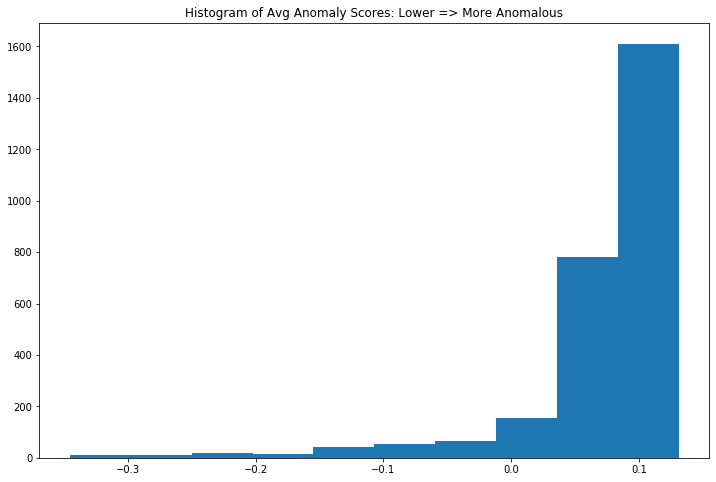

In [114]:
plt.figure(figsize=(12,8))
plt.hist(if_scores);
plt.title('Histogram of Avg Anomaly Scores: Lower => More Anomalous');

In [86]:
len(outlier_index)#total outlier

331

### Visualize Isolation Forest result by PCA 

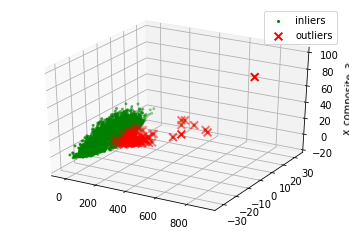

In [89]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
pca = PCA(n_components=3)  # Reduce to k=3 dimensions
scaler = StandardScaler()
#normalize the metrics
X = scaler.fit_transform(df)
X_reduce = pca.fit_transform(X)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_zlabel("x_composite_3")
# Plot the compressed data points
ax.scatter(X_reduce[:, 0], X_reduce[:, 1], zs=X_reduce[:, 2], s=4, lw=1, label="inliers",c="green")
# Plot x's for the ground truth outliers
ax.scatter(X_reduce[outlier_index,0],X_reduce[outlier_index,1], X_reduce[outlier_index,2],
           lw=2, s=60, marker="x", c="red", label="outliers")
ax.legend()
plt.show()

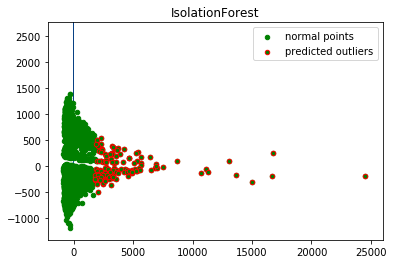

In [31]:
from sklearn.decomposition import PCA
pca = PCA(2)
pca.fit(df)
res=pd.DataFrame(pca.transform(df))
Z = np.array(res)
plt.title("IsolationForest")
plt.contourf( Z, cmap=plt.cm.Blues_r)
b1 = plt.scatter(res[0], res[1], c='green',
                 s=20,label="normal points")
b1 =plt.scatter(res.iloc[outlier_index,0],res.iloc[outlier_index,1], c='green',s=20,  edgecolor="red",label="predicted outliers")
plt.legend(loc="upper right")
plt.show()

## LOF with whole Data set

In [436]:
from sklearn.neighbors import LocalOutlierFactor
clf = LocalOutlierFactor(n_neighbors=20, contamination=.01,metric='euclidean')
y_pred = clf.fit_predict(test)
LOF_Scores = clf.negative_outlier_factor_
#LOF_pred=pd.Series(y_pred).replace([-1,1],[1,0])
#LOF_anomalies=df[LOF_pred==1]

pred = clf.fit_predict(testdf)

df['anomaly']=pred
outliers=df.loc[df['anomaly']==-1]
outlier_index=list(outliers.index)
#print(outlier_index)
#Find the number of anomalies and normal points here points classified -1 are anomalous
print(df['anomaly'].value_counts())




 1    2729
-1      28
Name: anomaly, dtype: int64


### LOF with summary statistics

In [435]:
from sklearn.neighbors import LocalOutlierFactor
clf = LocalOutlierFactor(n_neighbors=20, contamination=.01,metric='euclidean')
y_pred = clf.fit_predict(dfsummary)
LOF_Scores = clf.negative_outlier_factor_
pred = clf.fit_predict(dfsummary)
df['anomaly']=pred
outliers=df.loc[df['anomaly']==-1]
outlier_index=list(outliers.index)
#print(outlier_index)
#Find the number of anomalies and normal points here points classified -1 are anomalous
print(df['anomaly'].value_counts())

 1    2729
-1      28
Name: anomaly, dtype: int64


### Outlier_index for LOF with whole dataset


In [437]:
outlier_index

[5,
 14,
 23,
 59,
 238,
 313,
 369,
 383,
 506,
 550,
 730,
 788,
 1071,
 1095,
 1198,
 1437,
 1459,
 1630,
 2086,
 2215,
 2320,
 2477,
 2512,
 2543,
 2627,
 2659,
 2666,
 2684]

### Outlier_index for LOF with whole datasets

In [129]:
outlier_index

[5,
 13,
 14,
 23,
 33,
 59,
 96,
 238,
 313,
 384,
 506,
 730,
 788,
 1095,
 1118,
 1437,
 1486,
 2079,
 2086,
 2215,
 2236,
 2543,
 2625,
 2627,
 2659,
 2664,
 2666,
 2684]

### Visualization for LOF with whole dataset

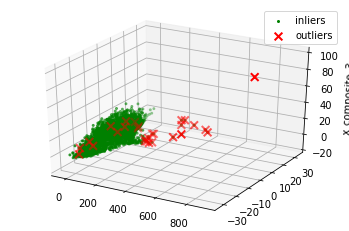

In [438]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
pca = PCA(n_components=3)  # Reduce to k=3 dimensions
scaler = StandardScaler()
#normalize the metrics
X = scaler.fit_transform(df)
X_reduce = pca.fit_transform(X)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_zlabel("x_composite_3")
# Plot the compressed data points
ax.scatter(X_reduce[:, 0], X_reduce[:, 1], zs=X_reduce[:, 2], s=4, lw=1, label="inliers",c="green")
# Plot x's for the ground truth outliers
ax.scatter(X_reduce[outlier_index,0],X_reduce[outlier_index,1], X_reduce[outlier_index,2],
           lw=2, s=60, marker="x", c="red", label="outliers")
ax.legend()
plt.show()

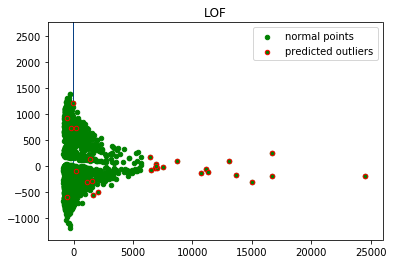

In [439]:
from sklearn.decomposition import PCA
pca = PCA(2)
pca.fit(df)
res=pd.DataFrame(pca.transform(df))
Z = np.array(res)
plt.title("LOF")
plt.contourf( Z, cmap=plt.cm.Blues_r)
b1 = plt.scatter(res[0], res[1], c='green',
                 s=20,label="normal points")
b1 =plt.scatter(res.iloc[outlier_index,0],res.iloc[outlier_index,1], c='green',s=20,  edgecolor="red",label="predicted outliers")
plt.legend(loc="upper right")
plt.show()

### Visualization for LOF with summary statistics

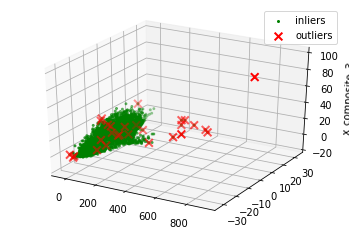

In [431]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
pca = PCA(n_components=3)  # Reduce to k=3 dimensions
scaler = StandardScaler()
#normalize the metrics
X = scaler.fit_transform(df)
X_reduce = pca.fit_transform(X)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_zlabel("x_composite_3")
# Plot the compressed data points
ax.scatter(X_reduce[:, 0], X_reduce[:, 1], zs=X_reduce[:, 2], s=4, lw=1, label="inliers",c="green")
# Plot x's for the ground truth outliers
ax.scatter(X_reduce[outlier_index,0],X_reduce[outlier_index,1], X_reduce[outlier_index,2],
           lw=2, s=60, marker="x", c="red", label="outliers")
ax.legend()
plt.show()

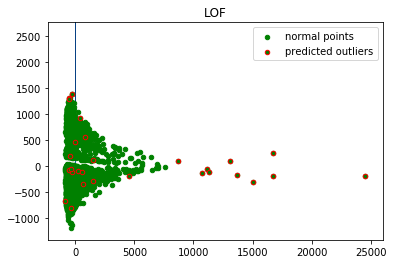

In [432]:
from sklearn.decomposition import PCA
pca = PCA(2)
pca.fit(df)
res=pd.DataFrame(pca.transform(df))
Z = np.array(res)
plt.title("LOF")
plt.contourf( Z, cmap=plt.cm.Blues_r)
b1 = plt.scatter(res[0], res[1], c='green',
                 s=20,label="normal points")
b1 =plt.scatter(res.iloc[outlier_index,0],res.iloc[outlier_index,1], c='green',s=20,  edgecolor="red",label="predicted outliers")
plt.legend(loc="upper right")
plt.show()

In [51]:
#pd.DataFrame(distance_matrix).to_csv("file.csv", header=None, index=None)

In [47]:
#pd.DataFrame(distance_matrix).to_csv("matrix.csv")

In [56]:
#np.savetxt('test.txt', distance_matrix)

In [59]:
import pickle
with open('the_filename', 'wb') as f:
    pickle.dump(distance_matrix, f)

import operator
def most_similar_patient(patient):
    d=dict()
    patient_num=[]
    similarity=dict()
    target_patient=dict_train[patient]
    l=[]
    distance_matrix=[]
    for event in range(0,len(target_patient)):
        icd=target_patient[event]['ICD_9']
        embedding=my_dict[icd]
        l.append(embedding)
    d[patient]=l
    for patients in dict_train:
        m=[]
        patient_event=dict_train[patients]
        for event in range(0,len(patient_event)):
            icd=patient_event[event]['ICD_9']
            embedding=my_dict[icd]
            m.append(embedding)
        d[patients]=m
    for key in d.keys():
        patient_num.append(key)
        distance, path = fastdtw(l,d[key],dist=euclidean)
        distance_matrix.append(distance)
    

    return(distance_matrix)

In [76]:
total=[]
for patient in dict_train:
    test1=[]
    for num in range (0,len(dict_train[patient])):
        test1.append(dict_train[patient][num]['ICD_9'])
    total.append(test1)

In [14]:
total

[['8052', '80701', '86403', '86801', 'E8210'],
 ['80703',
  '9671.0',
  '8602',
  '390.0',
  '390.0',
  'E8859',
  '9929.0',
  'E8490',
  '9904.0',
  '27651',
  '9963.0',
  '4580',
  '3404.0',
  '42789',
  '9604.0',
  '42611',
  '3891.0',
  '45829',
  'E9359',
  '4275',
  '25000',
  '4019',
  '41401',
  '412',
  '53081',
  '34690',
  '2720',
  '3619',
  '3669',
  '3051',
  '311',
  '2948',
  '3694',
  '3899'],
 ['80701',
  '9671.0',
  '86121',
  '9100',
  '9160',
  '30500',
  '7802',
  '4373',
  '4019',
  '311',
  'E8809'],
 ['41071',
  '3722.0',
  '42823',
  '8856.0',
  '99812',
  '8853.0',
  '41401',
  '4280',
  '4241',
  '25000',
  '496',
  '2767',
  '2724',
  '4019',
  '42789',
  'V4581',
  'V4582',
  'V5866',
  '4241',
  '3761.0',
  '42823',
  '3723.0',
  '41402',
  '8856.0',
  '80705',
  '9744.0',
  '41401',
  '8853.0',
  '4280',
  '42731',
  '45829',
  '496',
  '25000',
  '40390',
  '5859',
  '4148',
  '78820',
  '79092',
  '2859',
  '412',
  'V5861',
  'V4582',
  'V4986',
  'V6

In [27]:
icd_2080

array([[ 0.04037505,  0.20105314,  0.00892846, ..., -0.02433955,
         0.28710136, -0.20322277]], dtype=float32)

In [40]:
#for num in range (0,len(dict_train['175'])):
    #print(dict_train['175'][num])

In [322]:
for patient in respira_dict:
    try:
        for event in respira_dict[patient]:
            event.pop('event_type')
            if event.get('SHORT_TITLE'):
                event.pop('SHORT_TITLE')
            if event.get('FORMULARY_DRUG_CD'):
                event['ICD_9'] = event.pop('FORMULARY_DRUG_CD')
    except:pass

In [31]:
#patient_dict

### Glove Test

In [84]:
import itertools
from gensim.models.word2vec import Text8Corpus
from glove import Corpus, Glove
#importing the glove library

In [87]:
corpus = Corpus()
# fitting the corpus with sentences and creating Glove object
corpus.fit(total, window=10)
glove = Glove(no_components=100, learning_rate=0.05)
# fitting to the corpus and adding standard dictionary to the object
glove.fit(corpus.matrix, epochs=30, no_threads=4, verbose=True)
glove.add_dictionary(corpus.dictionary)
glove.save('glove.model')

Performing 30 training epochs with 4 threads
Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4
Epoch 5
Epoch 6
Epoch 7
Epoch 8
Epoch 9
Epoch 10
Epoch 11
Epoch 12
Epoch 13
Epoch 14
Epoch 15
Epoch 16
Epoch 17
Epoch 18
Epoch 19
Epoch 20
Epoch 21
Epoch 22
Epoch 23
Epoch 24
Epoch 25
Epoch 26
Epoch 27
Epoch 28
Epoch 29


In [92]:
print (glove.word_vectors[glove.dictionary['9011']])

[-0.00717645 -0.00389219  0.02017271 -0.00828536  0.0134201  -0.01743313
  0.00716999  0.02174547 -0.00235273  0.01063507 -0.00409857  0.01845066
  0.01144315 -0.01329723 -0.00563691 -0.00787424  0.00251993 -0.00474871
 -0.02057493  0.0142762   0.00245565 -0.01407312  0.00381744  0.00554807
 -0.00894835 -0.0151616  -0.002503   -0.0047683  -0.01474622 -0.03083051
  0.00103514 -0.01064216 -0.01500744 -0.01782828 -0.00445588 -0.01168767
 -0.00075086  0.00365374  0.02354439  0.01118847 -0.01634753 -0.01821274
 -0.00042841 -0.00873567 -0.00618504 -0.00108142 -0.02860454  0.00439357
 -0.0225474   0.00236015 -0.01020595  0.00377107  0.00826775 -0.00737994
  0.01582242 -0.00037171 -0.00067665 -0.00666295  0.01010273 -0.00343251
  0.01870482 -0.01345873  0.0222247   0.0185055   0.01099713 -0.02287578
 -0.01626681  0.01987177 -0.00152402  0.00814363  0.00720519 -0.01749556
 -0.00737102 -0.0100727  -0.01519013 -0.0023383   0.00996897  0.00297061
  0.00008661  0.00659022 -0.00068605 -0.02105037  0

In [96]:
glove.most_similar('4822',number=10)

[('34400', 0.9823095210530448),
 ('118.0', 0.9805962371574113),
 ('9982', 0.9697355010183139),
 ('3453', 0.9693852568681097),
 ('03849', 0.969025401636135),
 ('48283', 0.96764268217082),
 ('41519', 0.9666267734301406),
 ('51884', 0.9591136887553708),
 ('110.0', 0.9586499953220796)]

# DTW Test

In [ ]:
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw

In [99]:
x = np.array([[1,1], [2,2], [3,3], [4,4], [5,5]])
y = np.array([[2,2], [3,3], [4,4]])
distance, path = fastdtw(x, y, dist=euclidean)
print(distance)

2.8284271247461903


In [ ]:
input_list_final = np.array(input_list)